# Import libraries

In [1]:
%load_ext autoreload
%matplotlib inline

In [2]:
import matplotlib.pyplot as plt

In [3]:
import os, sys
# sys.path.append(os.getcwd())

import time

from utility import mkdir_p, generate_image

import numpy as np


import torch
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch import nn
from torch import autograd
from torch import optim
import argparse
import csv

In [4]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [5]:
import glob
import cv2

In [6]:
import torchnet.meter.confusionmeter as cm
import pandas as  pd
import seaborn as sn

# Initialization

In [8]:
name='CatGan_i64_b128_e300_st'
results_dir='results'
image_size=64
batch_size=128
workers=0
noise_dim=100
dim= 64
data_dir='data/Kaggle_Monkey'
num_epochs=300
checkpoints_dir='checkpoints'
continue_train= False


In [9]:
dtype = torch.FloatTensor

In [10]:
mkdir_p(os.path.join(results_dir,name))
mkdir_p(os.path.join(checkpoints_dir,name))

# Data Load

In [11]:
#using torchvision ImageFolder for importing this dataset
transform = {
    'train': transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ColorJitter(),
        transforms.ToTensor(),
        transforms.Normalize(mean = [0.5,0.5,0.5], std = [0.5,0.5,0.5])
    ]),
    'val': transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ColorJitter(),
        transforms.ToTensor(),
        transforms.Normalize(mean = [0.5,0.5,0.5], std = [0.5,0.5,0.5])
    ])
}
trainData = torchvision.datasets.ImageFolder(root=data_dir+'/training',transform=transform['train'])
trainDataLoader = DataLoader(trainData,batch_size=batch_size,shuffle=True,num_workers=workers)
valData = torchvision.datasets.ImageFolder(root=data_dir+'/validation',transform=transform['val'])
valDataLoader = DataLoader(valData,batch_size=batch_size,shuffle=True,num_workers=workers)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

torch.Size([128, 3, 64, 64])
torch.Size([128])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

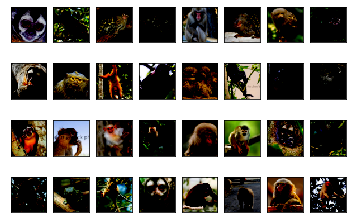

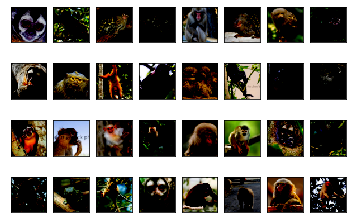

In [12]:
dataiter=iter(trainDataLoader)
images,labels=next(dataiter)
print(images.shape)
print(labels.shape)
fig = plt.figure()
for i in range(32):
    plt.subplot(4,8,i+1)
#     plt.tight_layout()
    plt.imshow(images[i].numpy().transpose((1, 2, 0)))
#     plt.title(labels[i])
    plt.xticks([])
    plt.yticks([])
fig

# Model

In [13]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
                # input is Z, going into a convolution
                nn.ConvTranspose2d(noise_dim, dim * 4, 4, 1, 0, bias=False),
                nn.BatchNorm2d(dim * 4),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (opt.dim*8) x 4 x 4
                nn.ConvTranspose2d(dim * 4, dim * 2, 4, 2, 1, bias=False),
                nn.BatchNorm2d(dim * 2),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (opt.dim*4) x 8 x 8
                nn.ConvTranspose2d(dim * 2, dim, 4, 2, 1, bias=False),
                nn.BatchNorm2d(dim),
                nn.LeakyReLU(0.2, inplace=True),
                # state size. (opt.dim*2) x 16 x 16
                nn.ConvTranspose2d(dim, 3, 4, 2, 1, bias=False),
                nn.Tanh()
                # state size. (nc) x 32 x 32
            )

    def forward(self, input):
        output = self.main(input)
        return output

In [14]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        main = nn.Sequential(
            nn.Conv2d(3,dim, 4, 2, 1, bias=False),
            nn.BatchNorm2d(dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.5),#64x16x16
            nn.Conv2d(dim, 2 * dim, 4, 2, 1, bias=False),
            nn.BatchNorm2d(2*dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.5),#128x8x8
            nn.Conv2d(2 * dim, 4 * dim, 4, 2, 1, bias=False),
            nn.BatchNorm2d(4*dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.5),#256x4x4
            nn.Conv2d(4*dim, 4*dim, 4),
            nn.BatchNorm2d(4*dim),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.5),#256x1x1
            nn.Conv2d(4*dim, 10, 1)
        )

        self.main = main
        self.softmax = nn.Softmax()

    def forward(self, input):
        output = self.main(input)
        output = output.view(-1, 10)
        output = self.softmax(output)
        return output


In [15]:

#marginalized entropy
def entropy1(y):
    y1 = autograd.Variable(torch.randn(y.size(1)).type(dtype), requires_grad=True)
    y2 = autograd.Variable(torch.randn(1).type(dtype), requires_grad=True)
    y1 = y.mean(0)
    y2 = -torch.sum(y1*torch.log(y1+1e-6))

    return y2



# entropy
def entropy2(y):
    y1 = autograd.Variable(torch.randn(y.size()).type(dtype), requires_grad=True)
    y2 = autograd.Variable(torch.randn(1).type(dtype), requires_grad=True)
    y1 = -y*torch.log(y+1e-6)

    y2 = 1.0/batch_size*y1.sum()
    return y2

In [16]:
netG = Generator()
netD = Discriminator()

#continue traning by loading the latest model or the model specified in --netG and --netD
if continue_train:
    if netG != '':
        netG.load_state_dict(torch.load(netG))
    else:
        netG.load_state_dict(torch.load('%s/netG_latest.pth' % (os.path.join(checkpoints_dir,name))))


    if netD != '':
        netD.load_state_dict(torch.load(netD))
    else:
        netD.load_state_dict(torch.load('%s/netD_latest.pth' % (os.path.join(checkpoints_dir,name))))



print (netG)
print (netD)

use_cuda = torch.cuda.is_available()

if use_cuda:
    print('Using cuda')
    netD = netD.cuda()
    netG = netG.cuda()

one = torch.tensor(1, dtype=torch.float)# torch.FloatTensor([1])
mone = one * -1

if use_cuda:
    one = one.cuda()
    mone = mone.cuda()

optimizerD = optim.Adam(netD.parameters(), lr=2e-4, betas=(0.5, 0.9))
optimizerG = optim.Adam(netG.parameters(), lr=2e-4, betas=(0.5, 0.9))

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)
Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(

# Training

In [17]:
print("Start training on %s dataset which contains %d images..." %(name, len(trainData)))
iter_idx = 0
# with open(os.path.join(results_dir, name, 'log_monkey.csv'), 'w') as log:
#     log_writer = csv.writer(log, delimiter=',')
rows=[]
rows.append(['Iteration','Epoch','D_cost','G_cost', 'Entropy2_real','Entropy_fake'])
D_loss=[]
G_loss=[]
for epoch in range(num_epochs):
    start_time = time.time()

    for batch_idx, (real, labels) in enumerate(trainDataLoader):
        ###########################
        # (1) Update D network
        ###########################

        #freeze G and update D
        for p in netD.parameters():  
            p.requires_grad = True  
        for p in netG.parameters(): 
            p.requires_grad = False  
        netD.zero_grad()

        #################
        # train with real
        #################
        if use_cuda:
            real = autograd.Variable(real.cuda())

        D_real = netD(real)
        # minimize entropy to make certain prediction of real sample
        entorpy2_real = entropy2(D_real)
        entorpy2_real.backward(one, retain_graph=True)

        # maximize marginalized entropy over real samples to ensure equal usage
        entropy1_real = entropy1(D_real)
        entropy1_real.backward(mone)

        #################
        # train with fake
        #################
        noise = torch.randn(batch_size, noise_dim, 1, 1)
        if use_cuda:
            noise = autograd.Variable(noise.cuda())  # totally freeze netG

        fake = netG(noise)
        D_fake = netD(fake)

        #minimize entropy to make uncertain prediction of fake sample
        entorpy2_fake = entropy2(D_fake)
        entorpy2_fake.backward(mone)


        D_cost = entropy1_real + entorpy2_real + entorpy2_fake
        optimizerD.step()
        ############################
        # (2) Update G network
        ###########################

        #freeze D and update G
        for p in netD.parameters():
            p.requires_grad = False  
        for p in netG.parameters():
            p.requires_grad = True  
        netG.zero_grad()


        noise = torch.randn(batch_size, noise_dim, 1, 1)
        noise = autograd.Variable(noise.cuda())
        fake = netG(noise)
        D_fake = netD(fake)

        #fool D to make it believe the generated samples are real
        entropy2_fake = entropy2(D_fake)
        entropy2_fake.backward(one, retain_graph=True)

        #ensure equal usage of fake samples
        entropy1_fake = entropy1(D_fake)
        entropy1_fake.backward(mone)

        G_cost = entropy2_fake + entropy1_fake
        optimizerG.step()


        D_cost = D_cost.cpu().data.numpy()
        G_cost = G_cost.cpu().data.numpy()
        entorpy2_real = entorpy2_real.cpu().data.numpy()
        entorpy2_fake = entorpy2_fake.cpu().data.numpy()


        # Write losses to logs 
        if iter_idx%100==0:
            rows.append([iter_idx,epoch, D_cost,G_cost,entorpy2_real,entorpy2_fake])
#             log_writer.writerow([D_cost,G_cost,entorpy2_real,entorpy2_fake])
            D_loss.append(D_cost)
            G_loss.append(G_cost)
            print ("iter%d[epoch %d/ %d]\t %s %.4f \t %s %.4f \t %s %.4f \t %s %.4f" % (iter_idx, epoch,num_epochs,
                                                         'errD', D_cost,
                                                         'errG', G_cost,
                                                         'errD_real', entorpy2_real,
                                                         'errD_fake', entorpy2_fake ))

        #checkpointing the latest model every 500 iteration
        if iter_idx % 500 == 0:
            torch.save(netG.state_dict(), '%s/netG_latest.pth' % (os.path.join(checkpoints_dir,name)))
            torch.save(netD.state_dict(), '%s/netD_latest.pth' % (os.path.join(checkpoints_dir, name)))

        iter_idx += 1


    # generate samples every 2 epochs for surveillance
    if epoch % 2 == 0:
        generate_image(epoch, netG, results_dir, name,image_size, noise_dim )


    # do checkpointing every 20 epochs
    if epoch % 20 == 0:
        torch.save(netG.state_dict(), '%s/netG_epoch_%d.pth' % (os.path.join(checkpoints_dir, name), epoch))
        torch.save(netD.state_dict(), '%s/netD_epoch_%d.pth' % (os.path.join(checkpoints_dir, name), epoch))

Start training on CatGan_i64_b128_e300_st dataset which contains 1097 images...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.


iter0[epoch 0/ 300]	 errD 58.8106 	 errG 4.4491 	 errD_real 54.3451 	 errD_fake 2.1632


/notebooks/CatGan/utility.py:54: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  noisev = autograd.Variable(fixed_noise_128, volatile=True)


iter100[epoch 11/ 300]	 errD 19.6418 	 errG 3.4925 	 errD_real 16.1639 	 errD_fake 1.2430
iter200[epoch 22/ 300]	 errD 12.0562 	 errG 3.4990 	 errD_real 8.6303 	 errD_fake 1.2156
iter300[epoch 33/ 300]	 errD 9.3339 	 errG 3.5460 	 errD_real 5.9337 	 errD_fake 1.2201
iter400[epoch 44/ 300]	 errD 7.9206 	 errG 3.5839 	 errD_real 4.4415 	 errD_fake 1.3462
iter500[epoch 55/ 300]	 errD 7.1869 	 errG 3.6991 	 errD_real 3.5534 	 errD_fake 1.4587
iter600[epoch 66/ 300]	 errD 7.0136 	 errG 3.7871 	 errD_real 3.3135 	 errD_fake 1.5250
iter700[epoch 77/ 300]	 errD 6.2833 	 errG 3.8132 	 errD_real 2.5911 	 errD_fake 1.5121
iter800[epoch 88/ 300]	 errD 4.8268 	 errG 3.7893 	 errD_real 1.1254 	 errD_fake 1.5130
iter900[epoch 100/ 300]	 errD 5.5883 	 errG 3.8212 	 errD_real 1.8899 	 errD_fake 1.5023
iter1000[epoch 111/ 300]	 errD 5.9673 	 errG 3.7997 	 errD_real 2.2574 	 errD_fake 1.5731
iter1100[epoch 122/ 300]	 errD 5.8792 	 errG 3.8681 	 errD_real 2.1276 	 errD_fake 1.5523
iter1200[epoch 133/ 300]

In [ ]:
## writing output

In [18]:
with open(os.path.join(results_dir, name, name+'.csv'), 'w') as log:
    log_writer = csv.writer(log, delimiter=',')
    log_writer.writerows(rows)

# Displaying Generated Sample Images 

In [19]:

imgdir= 'results/'+name+'/'
files= glob.glob(imgdir+'*.jpg')
len_files=len(files)

img_list=[]
sorted_numbers=[]
for f in files:
#     print(f)
    words=f.split('/')
    fignum=words[2]
    words2= fignum.split('_')
    words3= words2[1].split('.')
#     print(words3)
    sorted_numbers.append(int(words3[0]))
#     image=cv2.imread(f)
#     img_list.append(image)
sorted_files=sorted(sorted_numbers)
for f in sorted_files:
    image=cv2.imread(imgdir+'samples_'+str(f)+'.jpg')
    img_list.append(image)
print(len(img_list))

150


Animation size has reached 21292537 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


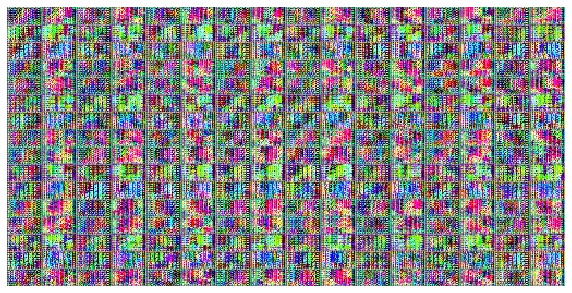

In [29]:
#%%capture

fig = plt.figure(figsize=(10,8))
plt.axis("off")
ims = [[plt.imshow(i, animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [32]:
!brew install imagemagick

/bin/sh: 1: brew: not found


In [35]:
ani.save(name+'.gif', writer='imagemagick', fps=1)


MovieWriter imagemagick unavailable; trying to use <class 'matplotlib.animation.PillowWriter'> instead.


In [21]:
import torchvision.utils as vutils

In [22]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [23]:
noise = torch.randn(64, 100, 1, 1, device=device)

# Turn off gradient calculation to speed up the process.
with torch.no_grad():
	# Get generated image from the noise vector using
	# the trained generator.
    generated_img = netG(noise).detach().cpu()


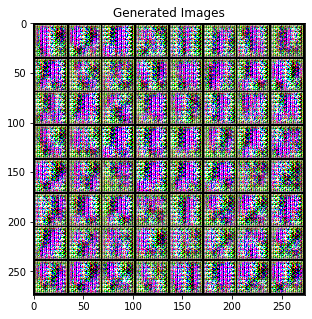

In [24]:
# Display the generated image.
plt.figure(figsize=(10,5))
# plt.axis("off")
plt.title("Generated Images")
plt.imshow(np.transpose(vutils.make_grid(generated_img, padding=2, normalize=True), (1,2,0)))
plt.show()

In [25]:
def blockshaped(arr, nrows, ncols):
    """
    Return an array of shape (n, nrows, ncols) where
    n * nrows * ncols = arr.size

    If arr is a 2D array, the returned array should look like n subblocks with
    each subblock preserving the "physical" layout of arr.
    """
    arr= arr.numpy()
    h, w = arr.shape
    assert h % nrows == 0, "{} rows is not evenly divisble by {}".format(h, nrows)
    assert w % ncols == 0, "{} cols is not evenly divisble by {}".format(w, ncols)
    return (arr.reshape(h//nrows, nrows, -1, ncols)
               .swapaxes(1,2)
               .reshape(-1, nrows, ncols))

In [26]:
## confusion matrix

In [27]:
class_names=['n0','n1','n2','n3','n4','n5','n6','n7','n8','n9']

In [28]:
#Get the confusion matrix for testing data
confusion_matrix = cm.ConfusionMeter(10)
with torch.no_grad():
    for i, (inputs, labels) in enumerate(valDataLoader):
        inputs = inputs.to(device)
        labels = labels.to(device)
#         print(inputs.shape)
#         print(labels.shape)
        discrim_outputs= netD(inputs)
#         print(discrim_outputs.shape)
        discrim_outputs=discrim_outputs.cpu()
        discrim_outputs=blockshaped(discrim_outputs.cpu(),int(discrim_outputs.shape[0]/inputs.shape[0]), 10 )
        discrim_outputs= torch.Tensor(discrim_outputs)
        pred_list=[]
#         print(discrim_outputs.shape)
        for j in discrim_outputs:
#             r=(np.mean(j,0))
#             predicted=np.where(np.amax(r,0))
            prob,pred=torch.max(j,0)
            prob1,pred1= torch.max(pred,0)
            pred_list.append(np.asscalar(pred1.numpy()))
        predicted=torch.Tensor(pred_list)
#         print(predicted.shape)
#         print(labels.shape)
        confusion_matrix.add(predicted, labels)
#         print(confusion_matrix.conf)
        #Confusion matrix as a heatmap
        con_m = confusion_matrix.conf
        df_con_m = pd.DataFrame(con_m, index= [i for i in class_names], columns = [i for i in class_names])
        print(df_con_m)
#         sn.set(font_scale= 1.1)
#         sn.heatmap(df_con_m, annot=True,fmt='g' ,  annot_kws={"size" : 10}, cbar = False, cmap="Blues") 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:21: DeprecationWarning: np.asscalar(a) is deprecated since NumPy v1.16, use a.item() instead


    n0  n1  n2  n3  n4  n5  n6  n7  n8  n9
n0   5   1   1   0   0   2   1   0   2   1
n1   0   2   3   0   0   1   0   3   2   1
n2   0   3   1   1   0   1   0   1   1   1
n3   2   2   0   0   1   4   2   3   1   1
n4   3   1   0   1   1   4   1   2   0   1
n5   0   1   2   0   0   3   1   2   1   1
n6   3   1   0   0   1   1   2   1   3   3
n7   3   1   2   3   2   0   0   6   1   0
n8   0   0   0   0   3   2   2   1   4   0
n9   1   3   0   0   2   1   1   0   0   0
    n0  n1  n2  n3  n4  n5  n6  n7  n8  n9
n0   6   2   1   2   1   4   2   0   3   2
n1   4   4   3   1   1   3   0   5   3   2
n2   5   4   2   5   0   4   0   2   1   2
n3   3   2   2   2   2   6   2   3   4   3
n4   5   3   0   2   1   4   1   3   3   2
n5   3   1   3   0   0   5   2   6   1   5
n6   4   2   1   0   3   2   3   2   4   5
n7   3   3   2   3   4   2   1   9   1   0
n8   1   0   2   2   4   5   2   3   4   1
n9   4   7   1   2   2   5   4   0   0   0
    n0  n1  n2  n3  n4  n5  n6  n7  n8  n9
n0   6   3 

In [ ]:
#Confusion matrix as a heatmap
# con_m = confusion_matrix.conf
# df_con_m = pd.DataFrame(con_m, index= [i for i in class_names], columns = [i for i in class_names])
# sn.set(font_scale= 1.1)
# sn.heatmap(df_con_m, annot=True,fmt='g' ,  annot_kws={"size" : 10}, cbar = False, cmap="Blues")